In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv('flight.csv')

In [3]:
df.head()

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,54993,11/2/2006,12/24/2008,Male,6,.,beijing,CN,31.0,3/31/2014,...,234188.0,580717,3/31/2014,1,3.483254,18,34,0.961639,619760,50
1,28065,2/19/2007,8/3/2007,Male,6,NaN,beijing,CN,42.0,3/31/2014,...,167434.0,293678,3/25/2014,7,5.194245,17,29,1.252314,415768,33
2,55106,2/1/2007,8/30/2007,Male,6,.,beijing,CN,40.0,3/31/2014,...,164982.0,283712,3/21/2014,11,5.298507,18,20,1.254676,406361,26
3,21189,8/22/2008,8/23/2008,Male,5,Los Angeles,CA,US,64.0,3/31/2014,...,125500.0,281336,12/26/2013,97,27.863636,73,11,1.090870,372204,12
4,39546,4/10/2009,4/15/2009,Male,6,guiyang,guizhou,CN,48.0,3/31/2014,...,130702.0,309928,3/27/2014,5,4.788079,47,27,0.970658,338813,39


In [4]:
df.shape

(62988, 23)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62988 entries, 0 to 62987
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   MEMBER_NO          62988 non-null  int64  
 1   FFP_DATE           62988 non-null  object 
 2   FIRST_FLIGHT_DATE  62988 non-null  object 
 3   GENDER             62985 non-null  object 
 4   FFP_TIER           62988 non-null  int64  
 5   WORK_CITY          60719 non-null  object 
 6   WORK_PROVINCE      59740 non-null  object 
 7   WORK_COUNTRY       62962 non-null  object 
 8   AGE                62568 non-null  float64
 9   LOAD_TIME          62988 non-null  object 
 10  FLIGHT_COUNT       62988 non-null  int64  
 11  BP_SUM             62988 non-null  int64  
 12  SUM_YR_1           62437 non-null  float64
 13  SUM_YR_2           62850 non-null  float64
 14  SEG_KM_SUM         62988 non-null  int64  
 15  LAST_FLIGHT_DATE   62988 non-null  object 
 16  LAST_TO_END        629

# **EDA**

### **Feature Description**

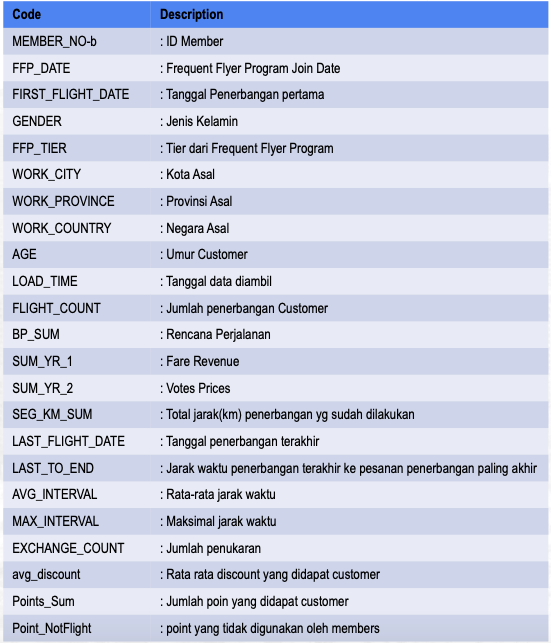

In [6]:
from PIL import Image
from IPython.display import display

# Load the image (replace 'image.jpg' with your image file path)
image = Image.open('Details.png')

# Display the image
display(image)

In [9]:
from pandas_profiling import ProfileReport
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**Analisis dari step ini adalah:**
1. Terdapat missing value dengan proporsi 0.5% atau sebanyak 6655 rows, selanjutnya akan didrop
2. Tidak ada duplicate row
3. Terdapat fitur FFP_DATE, FIRST_FLIGHT_DATE, LOAD_TIME, LAST_FLIGHT_DATE dengan value yang belum berupa datetime -> mengganti datatype
4. Nilai aneh pada avg_discount yaitu nilai maksimalnya 1.5 atau 150% yang tidak masuk akal untuk sebuah diskon. sehingga rows dengan value tsb akan didrop.
5. MEMBER_NO urutan customer memiliki nilai korelasi yang terendah terhadap fitur-fitur lain, sehingga akan didrop.
6. logtransform fitur-fitur dengan positively skewed distribution
7. handle outlier menggunakan z-score pada fitur yang memiliki outlier

In [10]:
# Drop missing value

df.isna().sum()

MEMBER_NO               0
FFP_DATE                0
FIRST_FLIGHT_DATE       0
GENDER                  3
FFP_TIER                0
WORK_CITY            2269
WORK_PROVINCE        3248
WORK_COUNTRY           26
AGE                   420
LOAD_TIME               0
FLIGHT_COUNT            0
BP_SUM                  0
SUM_YR_1              551
SUM_YR_2              138
SEG_KM_SUM              0
LAST_FLIGHT_DATE        0
LAST_TO_END             0
AVG_INTERVAL            0
MAX_INTERVAL            0
EXCHANGE_COUNT          0
avg_discount            0
Points_Sum              0
Point_NotFlight         0
dtype: int64

In [11]:
df = df.dropna()
df.isna().sum()

MEMBER_NO            0
FFP_DATE             0
FIRST_FLIGHT_DATE    0
GENDER               0
FFP_TIER             0
WORK_CITY            0
WORK_PROVINCE        0
WORK_COUNTRY         0
AGE                  0
LOAD_TIME            0
FLIGHT_COUNT         0
BP_SUM               0
SUM_YR_1             0
SUM_YR_2             0
SEG_KM_SUM           0
LAST_FLIGHT_DATE     0
LAST_TO_END          0
AVG_INTERVAL         0
MAX_INTERVAL         0
EXCHANGE_COUNT       0
avg_discount         0
Points_Sum           0
Point_NotFlight      0
dtype: int64

In [12]:
# Drop MEMBER_NO

df.drop(['MEMBER_NO'], inplace=True, axis=1)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 58255 entries, 0 to 62986
Data columns (total 22 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   FFP_DATE           58255 non-null  object 
 1   FIRST_FLIGHT_DATE  58255 non-null  object 
 2   GENDER             58255 non-null  object 
 3   FFP_TIER           58255 non-null  int64  
 4   WORK_CITY          58255 non-null  object 
 5   WORK_PROVINCE      58255 non-null  object 
 6   WORK_COUNTRY       58255 non-null  object 
 7   AGE                58255 non-null  float64
 8   LOAD_TIME          58255 non-null  object 
 9   FLIGHT_COUNT       58255 non-null  int64  
 10  BP_SUM             58255 non-null  int64  
 11  SUM_YR_1           58255 non-null  float64
 12  SUM_YR_2           58255 non-null  float64
 13  SEG_KM_SUM         58255 non-null  int64  
 14  LAST_FLIGHT_DATE   58255 non-null  object 
 15  LAST_TO_END        58255 non-null  int64  
 16  AVG_INTERVAL       582

#### CHANGE DATATYPE

In [13]:
date = ['FFP_DATE', 'FIRST_FLIGHT_DATE','LAST_FLIGHT_DATE', 'LOAD_TIME']

for i in date:
  df[i] = pd.to_datetime(df[i], format='%m/%d/%Y', errors='coerce')

df['AGE'] = df['AGE'].astype(int)

In [14]:
df[date].sample(10)

,FFP_DATE,FIRST_FLIGHT_DATE,LAST_FLIGHT_DATE,LOAD_TIME
33713,2012-06-21,2012-06-21,2013-02-04,2014-03-31
5776,2011-03-16,2011-04-17,2013-11-10,2014-03-31
51325,2012-11-06,2012-11-08,2013-06-22,2014-03-31
48548,2012-05-11,2012-06-08,2013-02-28,2014-03-31
32465,2011-09-28,2013-01-17,2014-01-07,2014-03-31
11693,2006-09-21,2006-09-21,2014-01-20,2014-03-31
39932,2010-04-29,2010-09-02,2014-03-20,2014-03-31
43342,2011-08-25,2011-08-25,2013-07-15,2014-03-31
50847,2007-09-19,2013-01-17,2013-05-06,2014-03-31
7881,2004-12-06,2005-03-23,2014-02-26,2014-03-31


In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 58255 entries, 0 to 62986
Data columns (total 22 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   FFP_DATE           58255 non-null  datetime64[ns]
 1   FIRST_FLIGHT_DATE  58255 non-null  datetime64[ns]
 2   GENDER             58255 non-null  object        
 3   FFP_TIER           58255 non-null  int64         
 4   WORK_CITY          58255 non-null  object        
 5   WORK_PROVINCE      58255 non-null  object        
 6   WORK_COUNTRY       58255 non-null  object        
 7   AGE                58255 non-null  int64         
 8   LOAD_TIME          58255 non-null  datetime64[ns]
 9   FLIGHT_COUNT       58255 non-null  int64         
 10  BP_SUM             58255 non-null  int64         
 11  SUM_YR_1           58255 non-null  float64       
 12  SUM_YR_2           58255 non-null  float64       
 13  SEG_KM_SUM         58255 non-null  int64         
 14  LAST_F

Terlihat ada jumlah yang berbeda pada kolom LAST_FLIGHT_DATE. Hal ini menandakan ada value aneh pada kolom tersebut.

In [16]:
df.isna().sum()

FFP_DATE               0
FIRST_FLIGHT_DATE      0
GENDER                 0
FFP_TIER               0
WORK_CITY              0
WORK_PROVINCE          0
WORK_COUNTRY           0
AGE                    0
LOAD_TIME              0
FLIGHT_COUNT           0
BP_SUM                 0
SUM_YR_1               0
SUM_YR_2               0
SEG_KM_SUM             0
LAST_FLIGHT_DATE     395
LAST_TO_END            0
AVG_INTERVAL           0
MAX_INTERVAL           0
EXCHANGE_COUNT         0
avg_discount           0
Points_Sum             0
Point_NotFlight        0
dtype: int64

In [23]:
df[df['LAST_FLIGHT_DATE']=='2014/2/29  0:00:00']
df['LAST_FLIGHT_DATE'] = df['LAST_FLIGHT_DATE'].replace('2014/2/29  0:00:00', '2/29/2014')

In [24]:
df = df.dropna()
df.isna().sum()

FFP_DATE             0
FIRST_FLIGHT_DATE    0
GENDER               0
FFP_TIER             0
WORK_CITY            0
WORK_PROVINCE        0
WORK_COUNTRY         0
AGE                  0
LOAD_TIME            0
FLIGHT_COUNT         0
BP_SUM               0
SUM_YR_1             0
SUM_YR_2             0
SEG_KM_SUM           0
LAST_FLIGHT_DATE     0
LAST_TO_END          0
AVG_INTERVAL         0
MAX_INTERVAL         0
EXCHANGE_COUNT       0
avg_discount         0
Points_Sum           0
Point_NotFlight      0
dtype: int64

In [29]:
df.sample(10)

,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,FLIGHT_COUNT,...,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
19750,2005-04-17,2006-01-09,Female,4,beijing,.,CN,38,2014-03-31,12,...,5850.0,20121,2013-12-17,106,46.363636,197,1,0.614844,11510,3
57473,2013-02-11,2013-03-24,Male,4,shenzhen,guangdong,CN,34,2014-03-31,4,...,1351.0,4155,2013-10-06,178,65.333333,88,0,0.396465,513,0
25475,2011-07-26,2011-11-22,Male,4,shenzhen,guangdong,CN,51,2014-03-31,12,...,1213.0,13605,2013-06-01,305,37.818182,147,0,0.684372,8082,0
37936,2009-12-09,2010-09-02,Male,4,guangzhou,guangdong,CN,30,2014-03-31,5,...,3049.0,7869,2014-01-17,75,138.500000,408,0,0.652037,9526,20
38931,2006-05-17,2006-06-14,Male,4,shanghai,shanghai,CN,54,2014-03-31,6,...,0.0,7411,2013-02-03,423,12.400000,38,0,0.660221,4360,0
59577,2011-01-06,2011-01-06,Female,4,guangzhou,guangdong,CN,48,2014-03-31,8,...,3370.0,1472,2014-02-10,51,86.571429,153,0,0.903750,4639,1
35689,2011-12-06,2013-12-13,Female,5,nanning,guangxizhuangzuzizhiqu,CN,34,2014-03-31,10,...,5943.0,8156,2014-03-14,18,10.222222,29,0,0.700614,4112,0
9974,2006-12-20,2007-05-04,Male,4,wulumuqishi,xinjiang,CN,63,2014-03-31,12,...,7362.0,28685,2013-09-28,186,42.636364,264,0,0.767423,19897,1
7710,2011-01-03,2011-02-08,Male,4,wulumuqi,xinjiang,CN,45,2014-03-31,10,...,10232.0,36389,2014-02-28,33,70.000000,178,0,0.721211,25496,1
22792,2012-05-14,2012-05-14,Male,4,wulumuqi,xinjiang,CN,41,2014-03-31,8,...,418.0,15047,2013-09-10,204,69.142857,186,0,0.708691,8228,0


In [30]:
# Terlihat ada value '.' pada fitur WORK_CITY & WORK_PROVINCE maka akan diganti 'Others'

df['WORK_CITY'] = df['WORK_CITY'].replace('.', 'Others')
df['WORK_PROVINCE'] = df['WORK_PROVINCE'].replace('.', 'Others')

In [31]:
df[df['WORK_CITY']=='Others']

,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,FLIGHT_COUNT,...,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,2006-11-02,2008-12-24,Male,6,Others,beijing,CN,31,2014-03-31,210,...,234188.0,580717,2014-03-31,1,3.483254,18,34,0.961639,619760,50
2,2007-02-01,2007-08-30,Male,6,Others,beijing,CN,40,2014-03-31,135,...,164982.0,283712,2014-03-21,11,5.298507,18,20,1.254676,406361,26
20,2008-07-30,2008-11-21,Male,6,Others,beijing,CN,49,2014-03-31,106,...,122763.0,167113,2014-03-28,4,6.438095,31,4,1.369404,251134,9
27,2005-01-15,2005-03-17,Male,6,Others,beijing,CN,47,2014-03-31,74,...,83139.0,148685,2014-03-21,11,9.493151,51,8,1.433364,235176,14
40,2006-04-25,2006-06-02,Male,6,Others,beijing,CN,48,2014-03-31,98,...,85119.0,137876,2014-03-30,2,7.505155,46,11,1.458541,210435,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61704,2007-05-01,2013-11-27,Male,6,Others,beijing,CN,59,2014-03-31,2,...,1001.0,1298,2013-11-28,125,1.000000,1,0,0.715000,854,0
61806,2011-04-20,2011-12-10,Male,4,Others,beijing,CN,40,2014-03-31,2,...,0.0,1586,2013-02-01,425,1.000000,1,0,0.571627,634,0
62035,2012-08-29,2013-10-16,Male,6,Others,beijing,CN,55,2014-03-31,2,...,1044.0,1199,2013-10-18,166,2.000000,2,0,0.707698,1133,3
62546,2012-06-03,2012-06-03,Male,4,Others,beijing,CN,44,2014-03-31,2,...,0.0,1629,2013-03-14,384,284.000000,284,0,0.417772,576,0


In [32]:
# Statistic Categorical
cats = []

for i in df.columns:
  if df[i].dtypes == 'object':
    cats.append(i)

df[cats].describe()

,GENDER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY
count,57860,57860,57860,57860
unique,2,2935,1123,105
top,Male,guangzhou,guangdong,CN
freq,44127,9223,17215,54572


In [33]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 57860 entries, 0 to 62986
Data columns (total 22 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   FFP_DATE           57860 non-null  datetime64[ns]
 1   FIRST_FLIGHT_DATE  57860 non-null  datetime64[ns]
 2   GENDER             57860 non-null  object        
 3   FFP_TIER           57860 non-null  int64         
 4   WORK_CITY          57860 non-null  object        
 5   WORK_PROVINCE      57860 non-null  object        
 6   WORK_COUNTRY       57860 non-null  object        
 7   AGE                57860 non-null  int64         
 8   LOAD_TIME          57860 non-null  datetime64[ns]
 9   FLIGHT_COUNT       57860 non-null  int64         
 10  BP_SUM             57860 non-null  int64         
 11  SUM_YR_1           57860 non-null  float64       
 12  SUM_YR_2           57860 non-null  float64       
 13  SEG_KM_SUM         57860 non-null  int64         
 14  LAST_F

#### FEATURE UNDERSTANDING

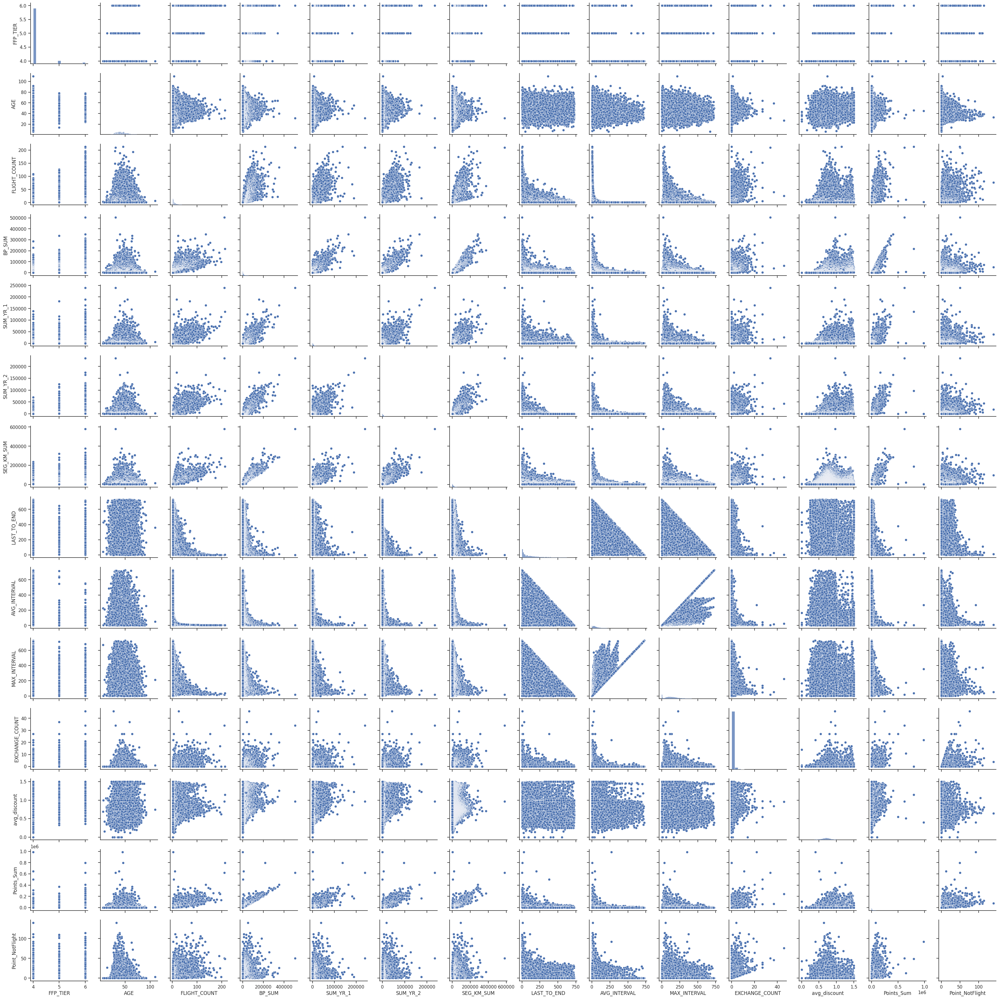

In [34]:
# Check the distribution plot

sns.set(style="ticks")
sns.pairplot(df)

plt.show()

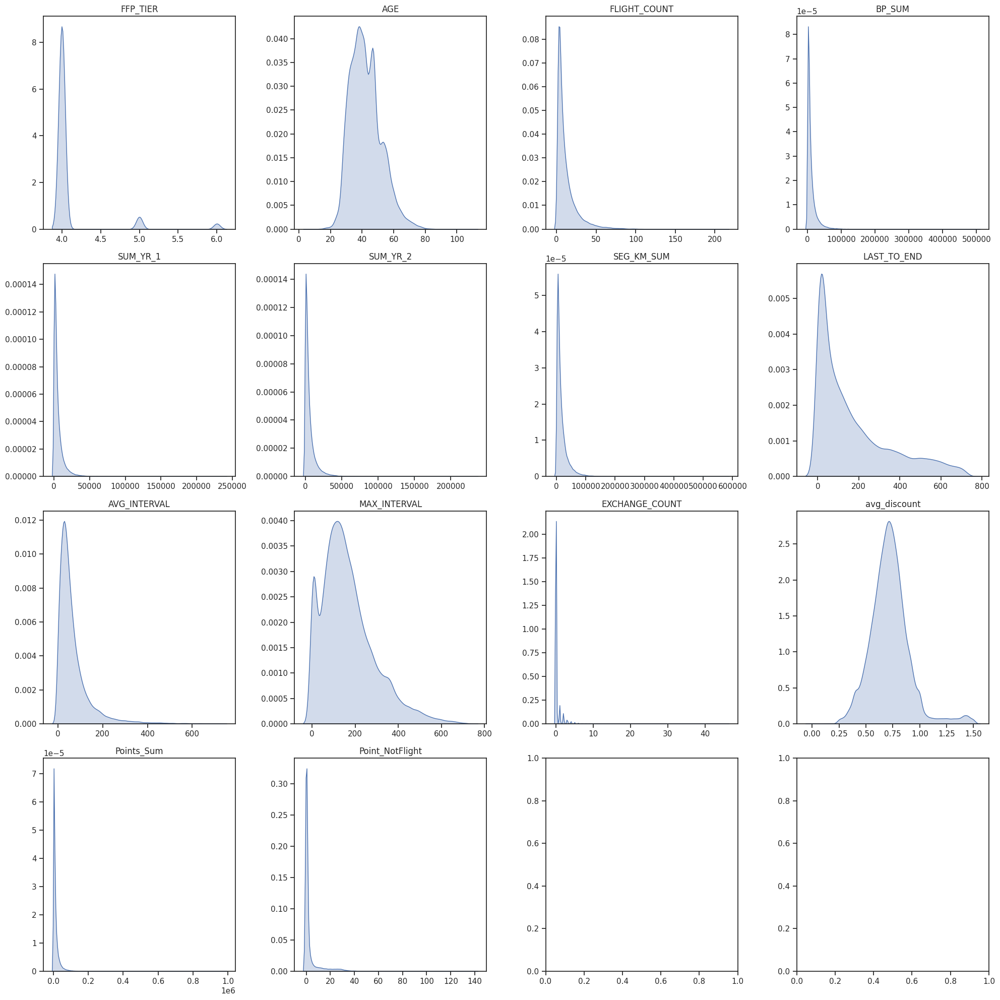

In [35]:
# Distribution of numeric features

nums = df.select_dtypes(include=[np.number], exclude=[np.bool]).columns
num_plots = len(nums)
plots_per_row = 4

num_rows = int(np.ceil(num_plots / plots_per_row))
fig, axes = plt.subplots(num_rows, plots_per_row, figsize=(20, 5 * num_rows))

for i in range(num_plots):
    row = i // plots_per_row
    col = i % plots_per_row
    ax = axes[row, col]

    sns.kdeplot(data=df, x=df[nums[i]], fill='True', ax=ax)
    ax.set_title(nums[i])
    ax.set_xlabel('')
    ax.set_ylabel('')

plt.tight_layout()
plt.show()

In [36]:
df.describe()

,FFP_TIER,AGE,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
count,57860.000000,57860.000000,57860.000000,57860.000000,57860.000000,57860.000000,57860.000000,57860.00000,57860.000000,57860.000000,57860.000000,57860.000000,57860.000000,57860.000000
mean,4.104666,42.233253,12.043000,11047.843726,5363.816955,5679.279658,17324.371863,172.20598,67.963638,167.221673,0.327981,0.720626,12721.368960,2.819703
std,0.378206,9.763364,14.239523,16294.179086,8110.434363,8714.783954,20982.734648,180.80718,77.533059,122.901236,1.149762,0.183942,20621.601695,7.497873
min,4.000000,6.000000,2.000000,0.000000,0.000000,0.000000,368.000000,1.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.000000,35.000000,3.000000,2599.750000,1020.000000,833.000000,4882.000000,28.00000,23.666667,81.000000,0.000000,0.612019,2863.000000,0.000000
50%,4.000000,41.000000,7.000000,5814.000000,2804.000000,2830.000000,10208.000000,105.00000,44.812500,144.000000,0.000000,0.711429,6468.000000,0.000000
75%,4.000000,48.000000,15.000000,12976.250000,6584.000000,6931.000000,21519.000000,259.25000,82.000000,228.000000,0.000000,0.808333,14491.000000,1.000000
max,6.000000,110.000000,213.000000,505308.000000,239560.000000,234188.000000,580717.000000,731.00000,728.000000,728.000000,46.000000,1.500000,985572.000000,140.000000


In [37]:
# Drop row value avg_discount dengan nilai >1
df = df[df['avg_discount']<=1]
df.describe()

,FFP_TIER,AGE,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
count,55236.000000,55236.000000,55236.000000,55236.000000,55236.000000,55236.000000,55236.000000,55236.000000,55236.000000,55236.000000,55236.000000,55236.000000,55236.000000,55236.000000
mean,4.084166,41.939749,11.845282,10173.446955,4988.616518,5291.465005,16977.997846,173.293323,68.120113,167.543251,0.307607,0.695668,11751.136922,2.819610
std,0.333184,9.645057,13.930732,14086.594093,7083.451866,7737.613607,20412.451150,181.025652,77.344765,123.036412,1.080020,0.143260,18126.515332,7.531904
min,4.000000,6.000000,2.000000,0.000000,0.000000,0.000000,368.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.000000,35.000000,3.000000,2497.000000,980.000000,806.000000,4845.000000,29.000000,23.833333,81.000000,0.000000,0.605921,2761.000000,0.000000
50%,4.000000,41.000000,7.000000,5578.000000,2710.000000,2733.000000,10089.500000,106.000000,45.000000,144.000000,0.000000,0.703387,6230.500000,0.000000
75%,4.000000,48.000000,15.000000,12288.250000,6305.250000,6608.000000,21141.250000,261.000000,82.400000,229.000000,0.000000,0.793887,13804.250000,1.000000
max,6.000000,110.000000,210.000000,505308.000000,239560.000000,234188.000000,580717.000000,731.000000,728.000000,728.000000,46.000000,1.000000,985572.000000,140.000000


Masih terdapat hal yang aneh, yaitu pada fitur SUM_YR_1, SUM_YR_2, SEG_KM_SUM.
Dimana terdapat passenger dengan value 0 pada avg_discount, SUM_YR_1 & SUM_YR_2 namun memiliki nilai > 0 pada SEG_KM_SUM. Karena, ketiga fitur di awal menandakan ada tidaknya perjalanan dari passenger, sehingga tidak masuk akal jika ada passenger yang tidak melakukan perjalanan dan tidak menukar diskon namun memiliki nilai SEG_KM_SUM atau total jarak perjalanan (Kilometer). **Ditindaklanjuti dengan cara didrop untuk rows dengan value-value di atas.**

In [38]:
# Drop kumpulan rows aneh

df.drop(df[(df['SUM_YR_1'] == 0) & (df['SUM_YR_2'] == 0) & (df['avg_discount'] == 0) & (df['SEG_KM_SUM'] > 0)].index, inplace = True)
df.describe()

,FFP_TIER,AGE,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
count,55229.000000,55229.000000,55229.000000,55229.000000,55229.000000,55229.000000,55229.000000,55229.000000,55229.000000,55229.000000,55229.000000,55229.000000,55229.000000,55229.000000
mean,4.084177,41.940575,11.846494,10174.736388,4989.248800,5292.135671,16979.645965,173.279292,68.124510,167.559833,0.307375,0.695757,11750.466404,2.818791
std,0.333203,9.645148,13.931196,14087.021119,7083.678088,7737.874608,20413.204502,181.021511,77.346174,123.033770,1.078507,0.143055,18122.790108,7.529951
min,4.000000,6.000000,2.000000,0.000000,0.000000,0.000000,368.000000,1.000000,0.000000,0.000000,0.000000,0.112043,0.000000,0.000000
25%,4.000000,35.000000,3.000000,2497.000000,980.000000,808.000000,4846.000000,29.000000,23.833333,81.000000,0.000000,0.605971,2761.000000,0.000000
50%,4.000000,41.000000,7.000000,5579.000000,2711.000000,2734.000000,10091.000000,106.000000,45.000000,144.000000,0.000000,0.703402,6232.000000,0.000000
75%,4.000000,48.000000,15.000000,12290.000000,6306.000000,6609.000000,21144.000000,261.000000,82.400000,229.000000,0.000000,0.793935,13805.000000,1.000000
max,6.000000,110.000000,210.000000,505308.000000,239560.000000,234188.000000,580717.000000,731.000000,728.000000,728.000000,46.000000,1.000000,985572.000000,140.000000


In [39]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 55229 entries, 0 to 62978
Data columns (total 22 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   FFP_DATE           55229 non-null  datetime64[ns]
 1   FIRST_FLIGHT_DATE  55229 non-null  datetime64[ns]
 2   GENDER             55229 non-null  object        
 3   FFP_TIER           55229 non-null  int64         
 4   WORK_CITY          55229 non-null  object        
 5   WORK_PROVINCE      55229 non-null  object        
 6   WORK_COUNTRY       55229 non-null  object        
 7   AGE                55229 non-null  int64         
 8   LOAD_TIME          55229 non-null  datetime64[ns]
 9   FLIGHT_COUNT       55229 non-null  int64         
 10  BP_SUM             55229 non-null  int64         
 11  SUM_YR_1           55229 non-null  float64       
 12  SUM_YR_2           55229 non-null  float64       
 13  SEG_KM_SUM         55229 non-null  int64         
 14  LAST_F

#### FEATURE SELECTION

Selanjutnya, berdasarkan sumber literatur jurnal internasional berikut ini:

1. https://iopscience.iop.org/article/10.1088/1742-6596/1168/3/032086/pdf
2. https://www.springerprofessional.de/en/analysis-method-for-customer-value-of-aviation-big-data-based-on/18303014

Kami mengadopsi model clustering LRFMC di atas menjadi dasar pembuatan model cluster data ini.

Penjelasan lebih lanjut mengenai LRFMC adalah sebagai berikut:
1. L (Loyalty): Jumlah bulan yang dihitung sejak awal membership hingga waktu pengamatan (unit: Month)
2. R (Recency): Jumlah hari sejak penerbangan terakhir hingga waktu pengamatan (unit: Day)
3. F (Frequency): Jumlah penerbangan penumpang (unit: time)
4. M (Monetery): Jumlah upgrade mileage penumpang hingga waktu pengamatan (unit: Kilometre)
5. C (Discount): Koefisien diskon ruang rata-rata selama periode waktu tertentu (unit: Percentage%)

Sehingga, sesuai dengan pengertian di atas maka fitur-fitur yang sesuai dnegan model LRFMC adalah sebagai berikut:
- L: LOAD_TIME - FFP_DATE: LOYALTY_MONTH (extract new feature)
- R: LAST_TO_END
- F: FLIGHT_COUNT
- M: SEG_KM_SUM
- C: avg_discount

In [40]:
# Choose selected features
features = ['FFP_DATE', 'LOAD_TIME', 'FLIGHT_COUNT', 'avg_discount', 'SEG_KM_SUM', 'LAST_TO_END']

dfx = df[features].copy()

In [41]:
# Extract new feature L
dfx['LOYALTY_MONTH'] = ((dfx['LOAD_TIME'] - dfx['FFP_DATE']).dt.days/30).astype(int)
dfx.sample(10)

,FFP_DATE,LOAD_TIME,FLIGHT_COUNT,avg_discount,SEG_KM_SUM,LAST_TO_END,LOYALTY_MONTH
6914,2005-12-11,2014-03-31,25,0.696014,40264,12,101
35330,2013-01-19,2014-03-31,5,0.497674,11692,96,14
6451,2012-03-14,2014-03-31,38,0.834448,35112,5,24
16538,2012-07-26,2014-03-31,21,0.753418,19472,9,20
54226,2012-05-23,2014-03-31,2,0.600000,3544,639,22
10571,2010-04-20,2014-03-31,43,0.737209,28638,56,48
47519,2010-07-13,2014-03-31,4,0.857500,3700,49,45
37686,2013-01-27,2014-03-31,5,0.954653,5448,96,14
44900,2012-05-15,2014-03-31,2,0.475000,7672,468,22
8992,2007-05-27,2014-03-31,28,0.657588,35936,60,83


In [42]:
lrfmc = ['LOYALTY_MONTH', 'LAST_TO_END','FLIGHT_COUNT','SEG_KM_SUM','avg_discount']
dfx_ftr = dfx[lrfmc].copy()
dfx_ftr.sample(10)

,LOYALTY_MONTH,LAST_TO_END,FLIGHT_COUNT,SEG_KM_SUM,avg_discount
47733,21,139,5,3422,0.916417
56229,14,426,2,2616,0.700000
9204,62,7,35,27802,0.835878
19272,73,74,16,19877,0.638388
36996,15,263,6,10704,0.501782
7426,68,70,15,32149,0.835211
28096,29,106,10,13436,0.608707
5965,82,38,27,50596,0.606623
38948,14,379,4,9953,0.491309
52177,56,108,2,2657,0.914806


### TRANSFORMATION AND HANDLING OUTLIER ON LRFMC FEATURES

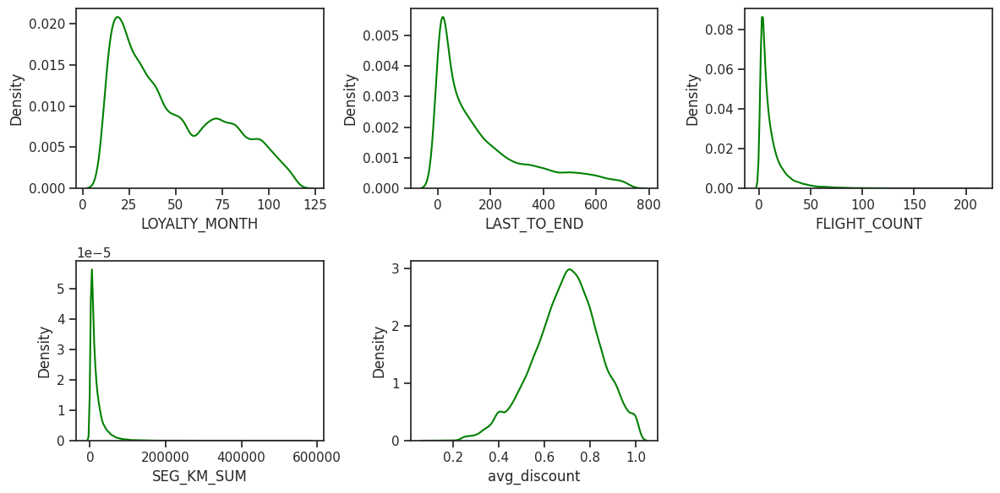

In [43]:
# Check the distribution of our LRFMC features

plt.figure(figsize=(12, 6))
for i in range(0, len(lrfmc)):
  plt.subplot(2, 3, i+1) # len(lrfmc), i+1
  sns.kdeplot(x=dfx_ftr[lrfmc[i]], color = 'green')
  plt.xlabel(lrfmc[i])
  plt.tight_layout()

Terlihat bahwa **semua fitur selain avg_discount** berdistribusi **skewed positif**. Maka, akan dilakukan **transformasi log1p** untuk mendapatkan **nilai log yang positif**.

In [44]:
# Transform LRFMC features with positively skewed

columns_to_transform = ['LOYALTY_MONTH', 'LAST_TO_END', 'FLIGHT_COUNT', 'SEG_KM_SUM']

# Apply log1p transformation to specified columns
dfx_ftr[columns_to_transform] = dfx_ftr[columns_to_transform].applymap(lambda x: np.log1p(x))

# Print the transformed DataFrame
print(dfx_ftr)

       LOYALTY_MONTH  LAST_TO_END  FLIGHT_COUNT  SEG_KM_SUM  avg_discount
0           4.510860     0.693147      5.351858   13.272021      0.961639
4           4.110874     1.791759      5.030438   12.644099      0.970658
5           4.317488     4.382027      4.532599   12.593326      0.967692
6           4.584967     0.693147      4.624973   12.567387      0.965347
7           3.891820     1.386294      4.304065   12.568042      0.962070
...              ...          ...           ...         ...           ...
62971       2.639057     5.888878      1.098612    7.000334      0.250000
62972       3.688879     5.198497      1.098612    7.557473      0.140000
62973       2.564949     5.880533      1.098612    6.634633      0.350000
62976       3.828641     3.688879      1.098612    6.968850      0.225000
62978       3.610918     5.645447      1.098612    6.634633      0.280000

[55229 rows x 5 columns]


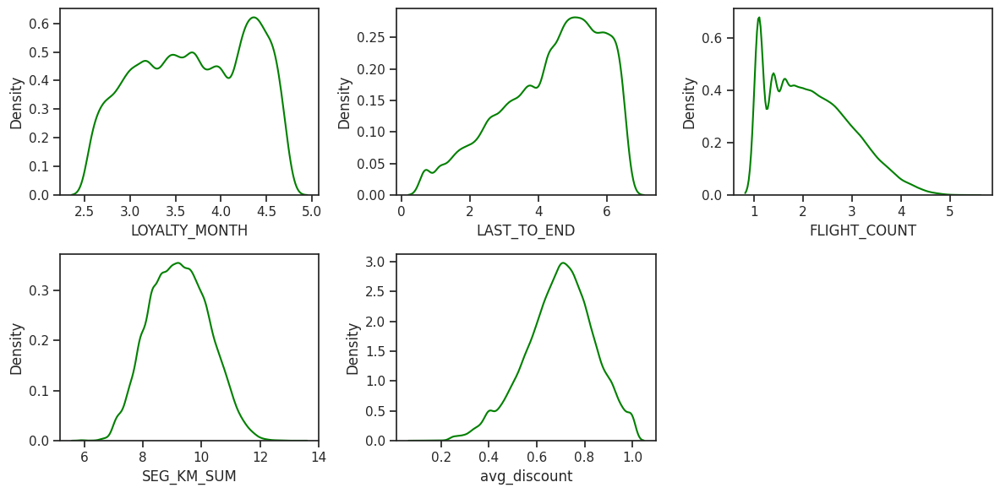

In [45]:
# Check the distribution of our LRFMC features

plt.figure(figsize=(12, 6))
for i in range(0, len(lrfmc)):
  plt.subplot(2, 3, i+1) # len(lrfmc), i+1
  sns.kdeplot(x=dfx_ftr[lrfmc[i]], color = 'green')
  plt.xlabel(lrfmc[i])
  plt.tight_layout()

**HANDLING OUTLIERS**

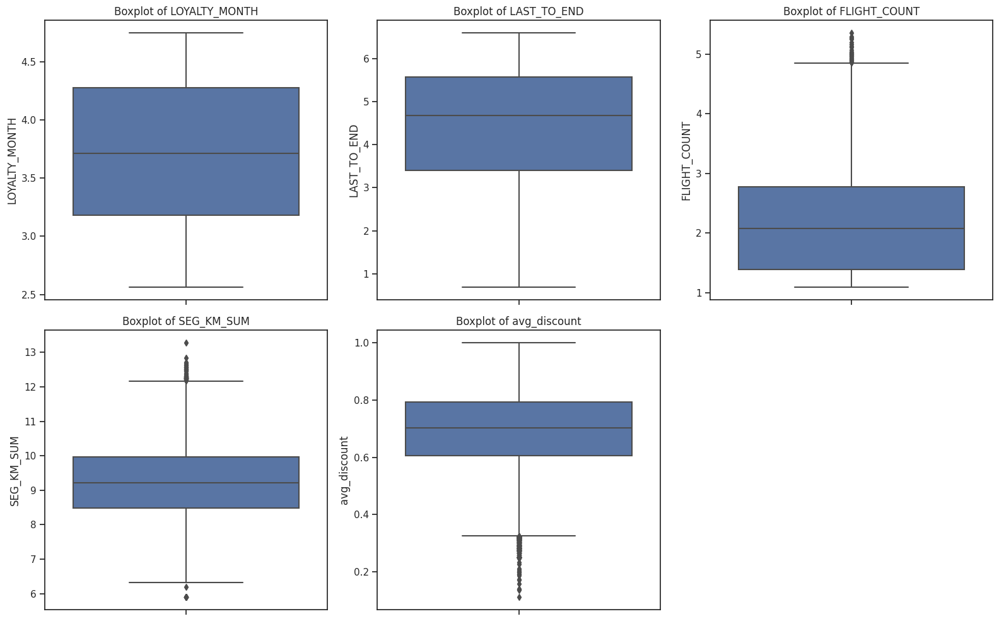

In [46]:
# Cek sebaran outlier

plt.figure(figsize=(16, 10))
for i, column in enumerate(lrfmc, 1):
    plt.subplot(2, 3, i)
    sns.boxplot(data=dfx_ftr, y=column)
    plt.title(f'Boxplot of {column}')
    plt.tight_layout()

plt.show()

In [47]:
# Handling outlier in LRFMC features using Z-score > 3

from scipy import stats

columns_to_handle = ['FLIGHT_COUNT', 'SEG_KM_SUM', 'avg_discount']

# Calculate the Z-scores for the specified columns
z_scores = np.abs(stats.zscore(dfx_ftr[columns_to_handle]))

# Define a Z-score threshold for outlier detection
z_score_threshold = 3

# Create a boolean mask for outliers
outlier_mask = z_scores > z_score_threshold

sum_of_outliers = outlier_mask.sum(axis=0)
print("Sum of outliers for each column:")
for column, count in zip(columns_to_handle, sum_of_outliers):
    print(f"{column}: {count}")

Sum of outliers for each column:
FLIGHT_COUNT: 98
SEG_KM_SUM: 42
avg_discount: 147


In [48]:
# Since the outlier is small, then we will remove them all!

dfx_ftr = dfx_ftr[~outlier_mask.any(axis=1)]

# Print the DataFrame with outliers removed
print(dfx_ftr)

       LOYALTY_MONTH  LAST_TO_END  FLIGHT_COUNT  SEG_KM_SUM  avg_discount
41          3.663562     1.386294      3.583519   12.211766      0.998555
62          3.850148     1.945910      4.442651   12.137912      0.938031
63          3.583519     2.708050      4.574711   12.228876      0.848240
66          4.356709     4.488636      3.496508   12.114856      0.944650
70          2.995732     4.143135      2.944439   12.254444      0.811871
...              ...          ...           ...         ...           ...
62951       2.639057     2.302585      1.098612    6.908755      0.307120
62952       2.890372     6.212606      1.098612    6.634633      0.400000
62959       2.639057     4.882802      1.098612    6.865891      0.290000
62973       2.564949     5.880533      1.098612    6.634633      0.350000
62978       3.610918     5.645447      1.098612    6.634633      0.280000

[54951 rows x 5 columns]


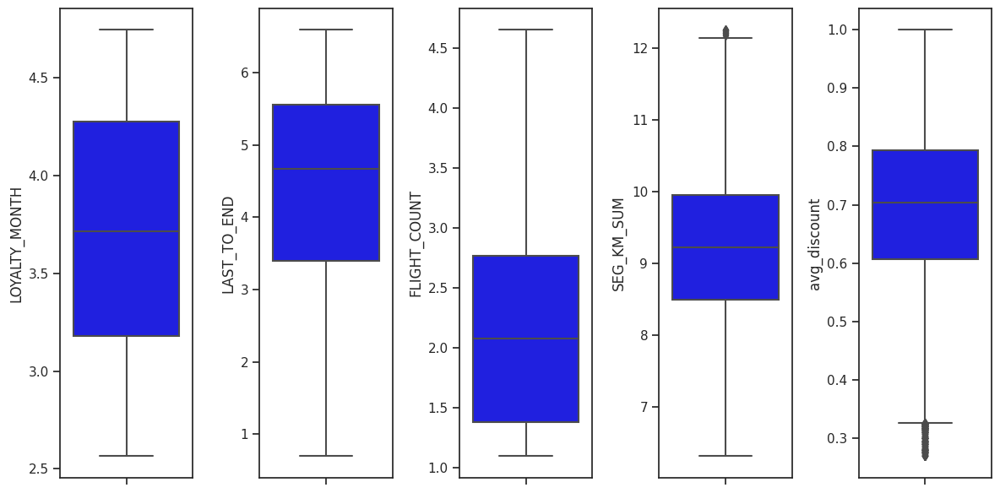

In [49]:
# Cek Boxplot after processing outlier
plt.figure(figsize=(12, 6))
for i in range(len(lrfmc)):
    plt.subplot(1, len(lrfmc), i+1)
    sns.boxplot(y=dfx_ftr[lrfmc[i]], color='blue', orient='v')
    plt.tight_layout()

## Clustering using K-Means

In [50]:
# Scale LRFMC features using standardscaler
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

data_std = StandardScaler().fit_transform(dfx_ftr)
dfx_std = pd.DataFrame(data=data_std, columns = lrfmc)
dfx_std

,LOYALTY_MONTH,LAST_TO_END,FLIGHT_COUNT,SEG_KM_SUM,avg_discount
0,-0.078898,-2.066123,1.724157,2.985217,2.135723
1,0.226265,-1.682598,2.772162,2.911172,1.707446
2,-0.209808,-1.160275,2.933254,3.002370,1.072063
3,1.054750,0.060025,1.618016,2.888057,1.754284
4,-1.171138,-0.176760,0.944580,3.028004,0.814712
...,...,...,...,...,...
54946,-1.754483,-1.438155,-1.307037,-2.331476,-2.757012
54947,-1.343456,1.241524,-1.307037,-2.606305,-2.099774
54948,-1.754483,0.330161,-1.307037,-2.374450,-2.878157
54949,-1.875687,1.013942,-1.307037,-2.606305,-2.453584


**Assume that we randomly pick 4 clusters first**

In [62]:
kmeans = KMeans(n_clusters=4, init= 'k-means++', max_iter= 300, n_init= 10, random_state= 42)
kmeans.fit(dfx_std.values)

KMeans(n_clusters=4, n_init=10, random_state=42)

In [63]:
dfx_std['label'] = kmeans.labels_
dfx_std

,LOYALTY_MONTH,LAST_TO_END,FLIGHT_COUNT,SEG_KM_SUM,avg_discount,label
0,-0.078898,-2.066123,1.724157,2.985217,2.135723,1
1,0.226265,-1.682598,2.772162,2.911172,1.707446,1
2,-0.209808,-1.160275,2.933254,3.002370,1.072063,1
3,1.054750,0.060025,1.618016,2.888057,1.754284,1
4,-1.171138,-0.176760,0.944580,3.028004,0.814712,3
...,...,...,...,...,...,...
54946,-1.754483,-1.438155,-1.307037,-2.331476,-2.757012,0
54947,-1.343456,1.241524,-1.307037,-2.606305,-2.099774,0
54948,-1.754483,0.330161,-1.307037,-2.374450,-2.878157,0
54949,-1.875687,1.013942,-1.307037,-2.606305,-2.453584,0


In [65]:
# PCA - split data
X = dfx_std.copy().drop(['label'], axis = 1)
Y = dfx_std['label'].copy()

In [66]:
scaler = StandardScaler()
scaler.fit(X)
X_std = scaler.transform(X)

In [67]:
pca = PCA(n_components = 2)
pca.fit(X_std)
X_pca = pca.transform(X_std)

dfz = pd.DataFrame(X_pca, columns = ['A', 'B'])
dfz['label'] = Y
dfz.sample(5)

,A,B,label
18604,0.199806,0.152338,2
12517,0.902746,-1.804573,2
9199,2.187052,0.875170,3
43095,-1.785090,0.822190,0
6491,2.201606,1.051960,1


<Axes: xlabel='A', ylabel='B'>

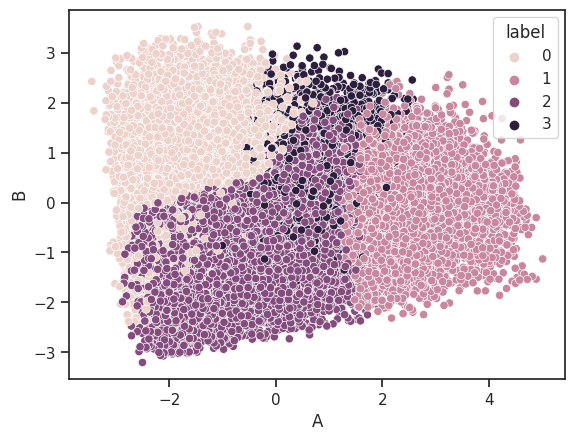

In [68]:
sns.scatterplot(data=dfz, x= 'A', y= 'B', hue= 'label')

**Now let's make sure how many cluster is the optimal cluster in our dataset**

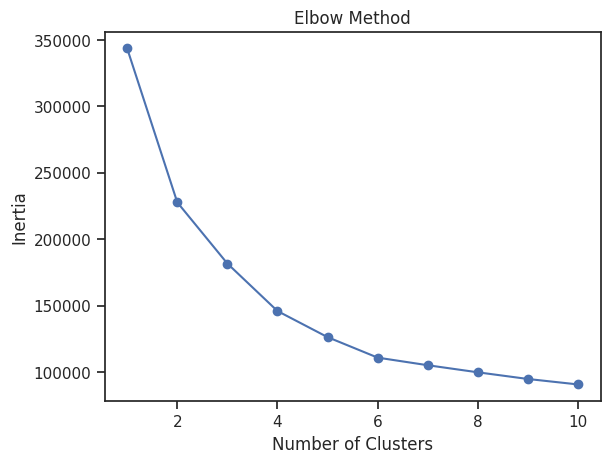

In [69]:
inertia = []
for num_clusters in range(1, 11):
    kmeans = KMeans(n_clusters= num_clusters, init= 'k-means++', max_iter= 300, n_init= 10, random_state= 42)
    kmeans.fit(dfx_std.values)
    inertia.append(kmeans.inertia_)

# Plot the elbow curve
import matplotlib.pyplot as plt
plt.plot(range(1, 11), inertia, marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()

Terlihat bahwa setelah patahan ke cluster 5 dst tidak terlalu signifikan. Namun, visualisasi tersebut belum terlalu meyakinkan untuk dapat menentukan jumlah cluster optimal. Maka, kita lihat pada data mentah.

In [70]:
pd.Series(inertia) - pd.Series(inertia).shift(-1)

0    115798.534199
1     46043.791528
2     35744.252914
3     19641.974993
4     15420.935682
5      5717.425373
6      5332.579838
7      5023.825985
8      4105.544070
9              NaN
dtype: float64

In [71]:
# Difference in percentage per cluster
(pd.Series(inertia) - pd.Series(inertia).shift(-1))/pd.Series(inertia)*100

0    33.704451
1    20.214867
2    19.669081
3    13.454893
4    12.205718
5     5.154504
6     5.068822
7     5.030317
8     4.328590
9          NaN
dtype: float64

Terlihat perbandingan gap penurunan inertia baik secara jumlah maupun persentase bahwa setelah dari gap cluster 4 ke 5, gap antar cluster menjadi tidak terlalu signifikan. Sehingga, jumlah cluster sebaiknya berhenti di cluster 5.

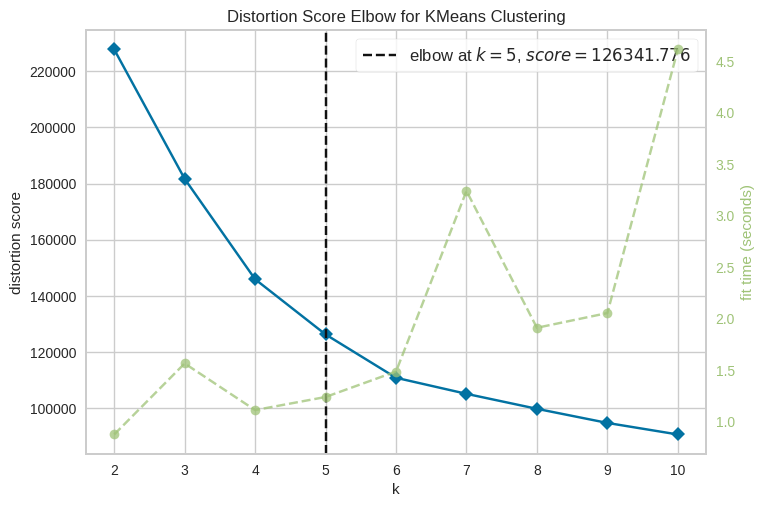

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [72]:
# Visualization of innertia vs k with parameter distortion
from yellowbrick.cluster import KElbowVisualizer

# fit model
model = KMeans(random_state=42)
visualizer = KElbowVisualizer(model, k=(2,11), metric='distortion', timings=True, locate_elbow=True)
visualizer.fit(dfx_std)
visualizer.show()

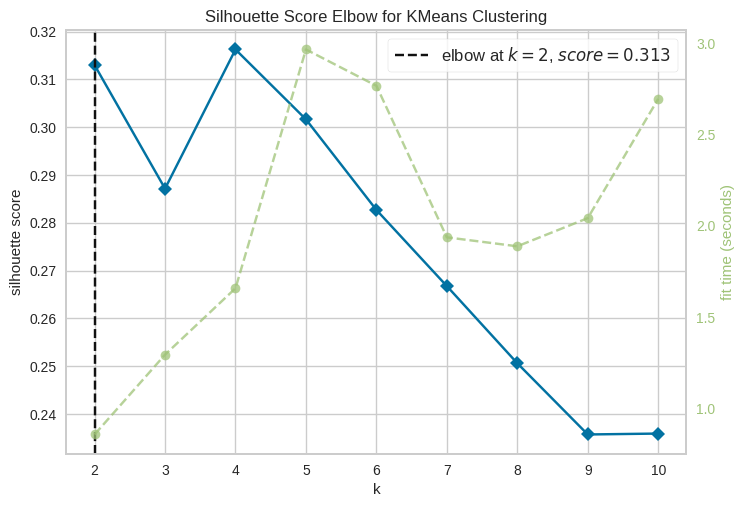

<Axes: title={'center': 'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

In [73]:
visualizer = KElbowVisualizer(kmeans, k=(2,11), metric='silhouette', timings=True, locate_elbow=True)
visualizer.fit(dfx_std)
visualizer.show()

Terdapat **perbedaan nilai n-cluster pada distortion score dan silhouette score**. Sehingga perlu untuk **melihat bagaimana distribusi untuk cluster 2 hingga 5**

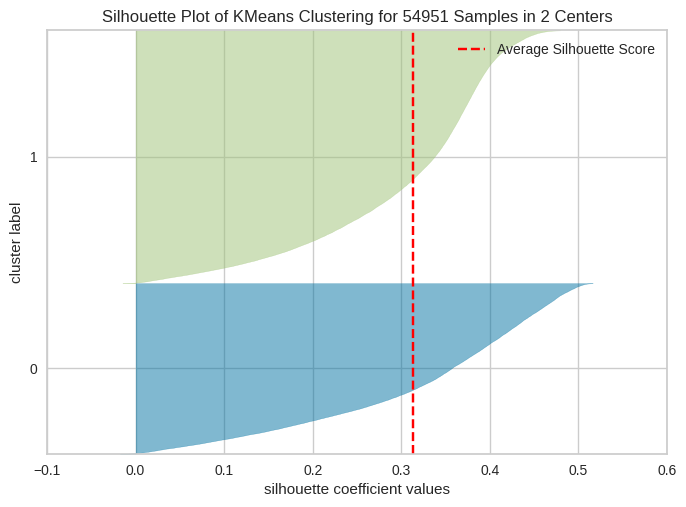

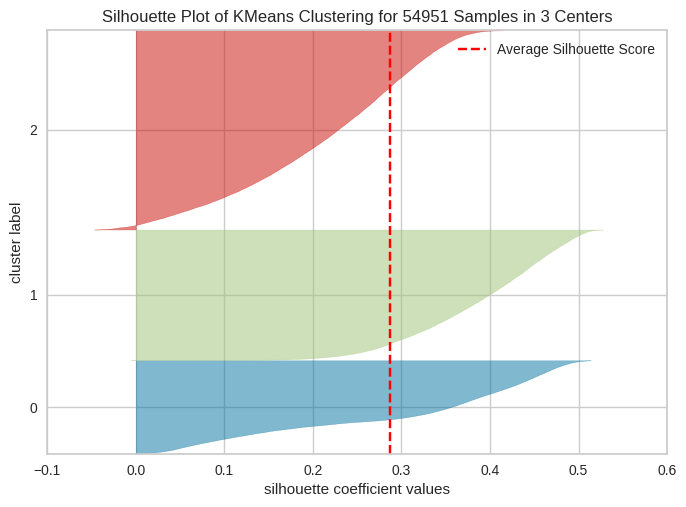

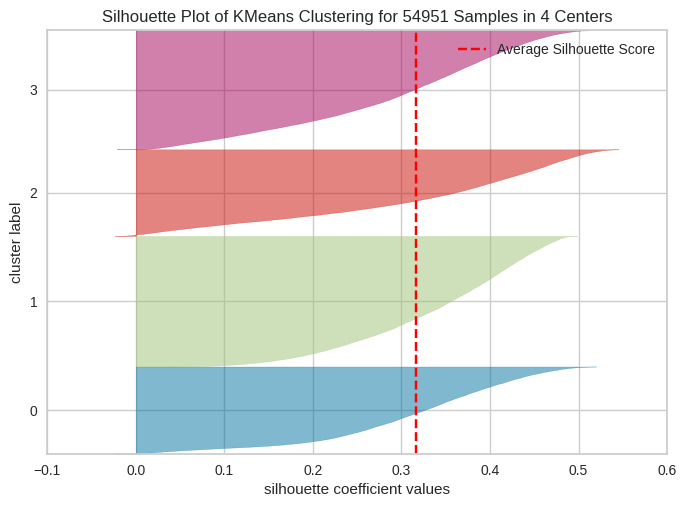

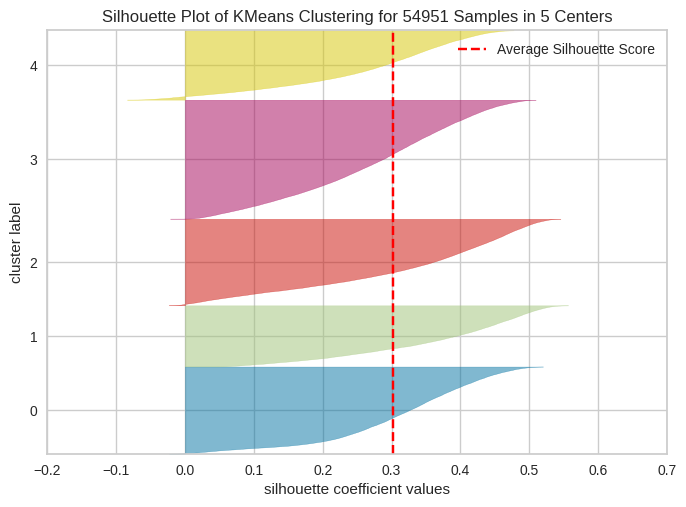

In [74]:
from yellowbrick.cluster import SilhouetteVisualizer

for num_clusters in [2, 3, 4, 5]:
    kmeans = KMeans(n_clusters=num_clusters, random_state=42)

    # Silhouette Visualizer
    visualizer = SilhouetteVisualizer(kmeans, colors='yellowbrick')
    visualizer.fit(dfx_std)
    visualizer.show()


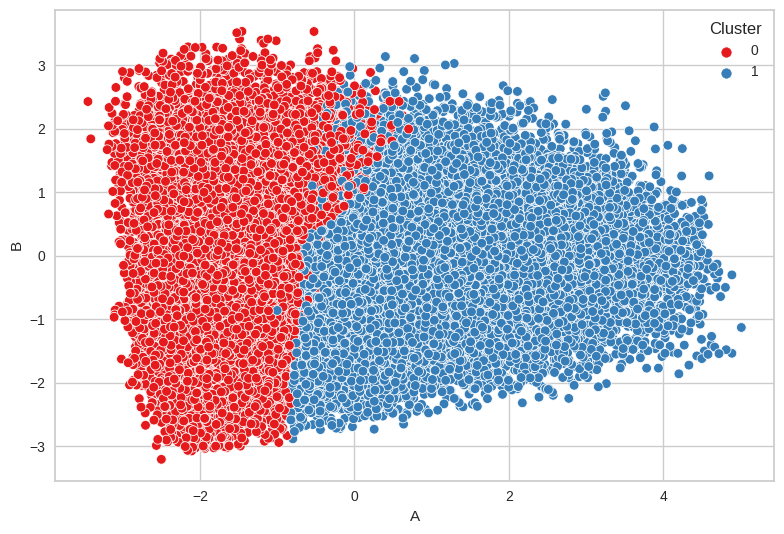

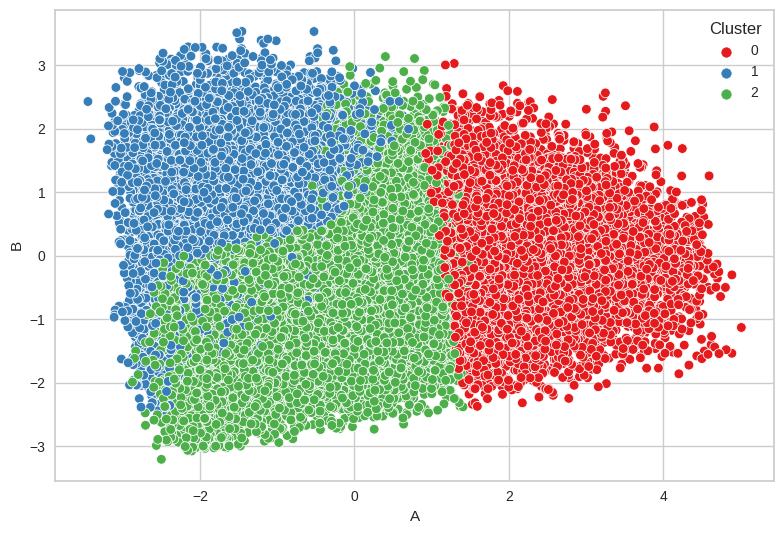

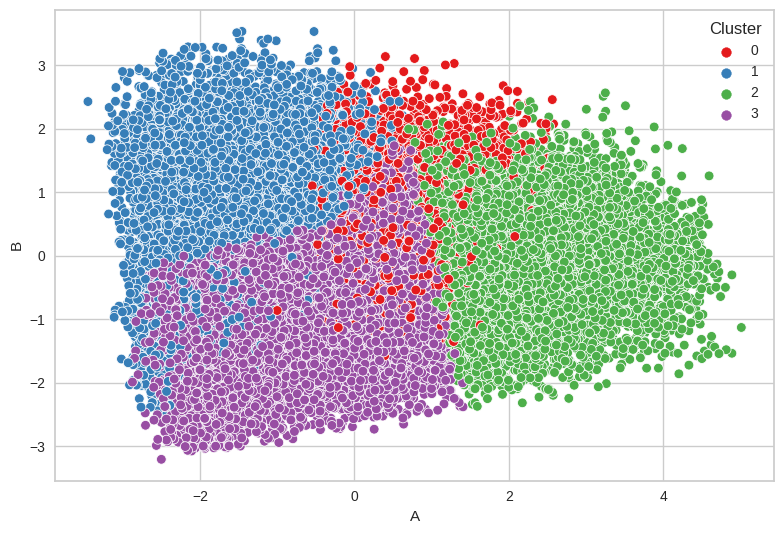

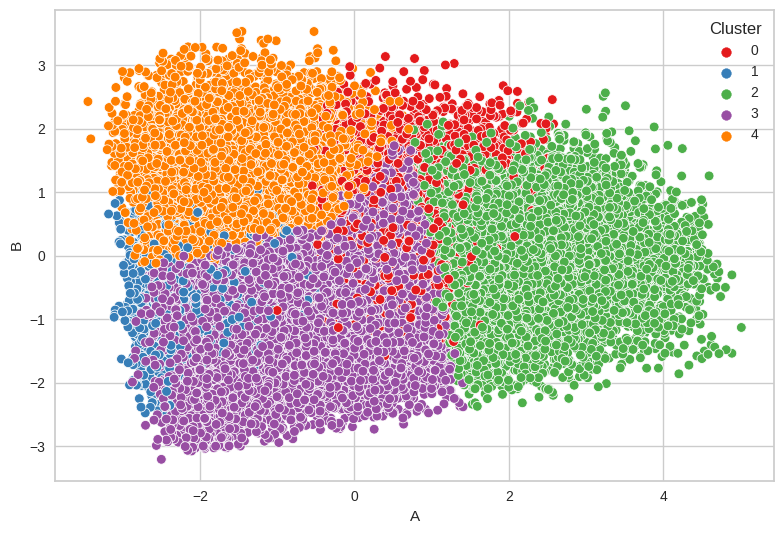

In [75]:
  # PCA - split data
X = dfx_std.copy().drop(['label'], axis = 1)
Y = dfx_std['label'].copy()

scaler = StandardScaler()
scaler.fit(X)
X_std = scaler.transform(X)

pca = PCA(n_components = 2)
pca.fit(X_std)
X_pca = pca.transform(X_std)

dfz = pd.DataFrame(X_pca, columns = ['A', 'B'])

for num_clusters in [2, 3, 4, 5]:
    kmeans = KMeans(n_clusters=num_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(dfx_std)

  # Scatter Plot of Cluster Assignments
    df_with_labels = dfz.copy()
    df_with_labels['Cluster'] = cluster_labels
    sns.scatterplot(data=df_with_labels, x='A', y='B', hue='Cluster', palette='Set1')
    ax.set_title(f'Scatter Plot of Data with {num_clusters} Clusters')
    ax.set_xlabel('A')
    ax.set_ylabel('B')

    plt.tight_layout()
    plt.show()

Selanjutnya, berdasarkan visualisasi di atas, kami ingin membandingkan antara cluster 4 dan 5.

### EVALUASI HASIL CLUSTERING 4 CLUSTER VS 5 CLUSTER

In [76]:
from sklearn.metrics import silhouette_score, adjusted_rand_score, mutual_info_score

columns_for_clustering = ['LOYALTY_MONTH', 'LAST_TO_END', 'FLIGHT_COUNT', 'SEG_KM_SUM', 'avg_discount']
data_for_clustering = dfx_std[columns_for_clustering]

# Perform K-Means clustering
num_clusters_4 = 4
num_clusters_5 = 5

kmeans_4 = KMeans(n_clusters=num_clusters_4, random_state=10)
kmeans_5 = KMeans(n_clusters=num_clusters_5, random_state=10)

cluster_labels_4 = kmeans_4.fit_predict(data_for_clustering)
cluster_labels_5 = kmeans_5.fit_predict(data_for_clustering)

# Calculate silhouette scores
silhouette_score_4 = silhouette_score(data_for_clustering, cluster_labels_4)
silhouette_score_5 = silhouette_score(data_for_clustering, cluster_labels_5)

print("Silhouette Score for 4 clusters:", silhouette_score_4)
print("Silhouette Score for 5 clusters:", silhouette_score_5)

if silhouette_score_4 > silhouette_score_5:
    optimal_num_clusters = num_clusters_4
else:
    optimal_num_clusters = num_clusters_5

print("Optimal number of clusters:", optimal_num_clusters)

Silhouette Score for 4 clusters: 0.21130986015750822
Silhouette Score for 5 clusters: 0.21620327447418533
Optimal number of clusters: 5


**EXTERNAL EVALUATION**

In [77]:
import random

num_samples = data_for_clustering.shape[0]
simulated_labels = [random.choice([0, 1, 2, 3]) for _ in range(num_samples)]

# Perform K-Means clustering for both options
num_clusters_4 = 4
num_clusters_5 = 5

kmeans_4 = KMeans(n_clusters=num_clusters_4, random_state=10)
kmeans_5 = KMeans(n_clusters=num_clusters_5, random_state=10)

cluster_labels_4 = kmeans_4.fit_predict(data_for_clustering)
cluster_labels_5 = kmeans_5.fit_predict(data_for_clustering)

# Calculate Adjusted Rand Index for both options
ari_4 = adjusted_rand_score(simulated_labels, cluster_labels_4)
ari_5 = adjusted_rand_score(simulated_labels, cluster_labels_5)

# Calculate Mutual Information for both options
mi_4 = mutual_info_score(simulated_labels, cluster_labels_4)
mi_5 = mutual_info_score(simulated_labels, cluster_labels_5)

# Compare ARI and MI scores and choose the higher one
if ari_4 > ari_5:
    optimal_ari_score = ari_4
    optimal_num_clusters_ari = num_clusters_4
else:
    optimal_ari_score = ari_5
    optimal_num_clusters_ari = num_clusters_5

if mi_4 > mi_5:
    optimal_mi_score = mi_4
    optimal_num_clusters_mi = num_clusters_4
else:
    optimal_mi_score = mi_5
    optimal_num_clusters_mi = num_clusters_5

# Choose the optimal number of clusters based on ARI and MI scores
if optimal_ari_score >= optimal_mi_score:
    optimal_num_clusters = optimal_num_clusters_ari
    optimal_score = optimal_ari_score
    optimal_metric = "ARI"
else:
    optimal_num_clusters = optimal_num_clusters_mi
    optimal_score = optimal_mi_score
    optimal_metric = "MI"

print("Optimal number of clusters:", optimal_num_clusters)
print("Optimal score:", optimal_score)
print("Optimal metric:", optimal_metric)

Optimal number of clusters: 5
Optimal score: 0.0001358887269003739
Optimal metric: MI


Karena berdasarkan beberapa tahapan uji dan validasi eksternal menunjukkan bahwa jumlah cluster optimal yang optimal adalah yang berjumlah 5 cluster. Maka, kami memutuskan untuk membuat **5 cluster** untuk data ini.

# K-MEANS WITH 5 CLUSTERS

In [78]:
kmeans = KMeans(n_clusters=5, init= 'k-means++', max_iter= 300, n_init= 10, random_state= 42)
kmeans.fit(dfx_std.values)

KMeans(n_clusters=5, n_init=10, random_state=42)

In [79]:
dfx_std['label'] = kmeans.labels_
dfx_std

,LOYALTY_MONTH,LAST_TO_END,FLIGHT_COUNT,SEG_KM_SUM,avg_discount,label
0,-0.078898,-2.066123,1.724157,2.985217,2.135723,2
1,0.226265,-1.682598,2.772162,2.911172,1.707446,2
2,-0.209808,-1.160275,2.933254,3.002370,1.072063,2
3,1.054750,0.060025,1.618016,2.888057,1.754284,2
4,-1.171138,-0.176760,0.944580,3.028004,0.814712,0
...,...,...,...,...,...,...
54946,-1.754483,-1.438155,-1.307037,-2.331476,-2.757012,4
54947,-1.343456,1.241524,-1.307037,-2.606305,-2.099774,4
54948,-1.754483,0.330161,-1.307037,-2.374450,-2.878157,4
54949,-1.875687,1.013942,-1.307037,-2.606305,-2.453584,4


In [80]:
#PCA - split
X = dfx_std.copy().drop(['label'], axis = 1)
Y = dfx_std['label'].copy()

In [81]:
scaler = StandardScaler()
scaler.fit(X)
X_std = scaler.transform(X)

In [82]:
pca = PCA(n_components = 2)
pca.fit(X_std)
X_pca = pca.transform(X_std)

dfc = pd.DataFrame(X_pca, columns = ['A', 'B'])
dfc['label'] = Y
dfc.sample(5)

,A,B,label
1305,3.442638,0.723697,2
19547,0.666833,-0.245388,3
49519,-1.223808,0.505070,4
53896,-2.455520,-2.771745,3
2353,2.445731,-1.475644,2


In [83]:
dfc.describe()

,A,B,label
count,5.495100e+04,5.495100e+04,54951.000000
mean,6.620405e-17,-2.482652e-17,2.052683
std,1.552949e+00,1.009031e+00,1.379220
min,-3.451664e+00,-3.205623e+00,0.000000
25%,-1.224650e+00,-6.806306e-01,1.000000
50%,-1.461357e-01,-4.863800e-03,2.000000
75%,1.083282e+00,6.683674e-01,3.000000
max,5.012672e+00,3.533772e+00,4.000000


In [84]:
# Check the statistics
dfc.groupby('label').agg(['mean', 'median', 'std', 'count'])

A                                    B                      \
           mean    median       std  count      mean    median       std   
label                                                                      
0      0.554507  0.524658  0.699806  11315  0.462535  0.464091  0.771437   
1     -1.587333 -1.568086  0.623001   7941 -0.420479 -0.340135  0.736257   
2      2.236088  2.124841  0.798860  11236 -0.092441 -0.089432  0.720570   
3     -0.384993 -0.290363  0.882975  15452 -0.745146 -0.693772  0.799810   
4     -1.426114 -1.411826  0.699300   9007  1.183313  1.129514  0.673089   

              
       count  
label         
0      11315  
1       7941  
2      11236  
3      15452  
4       9007

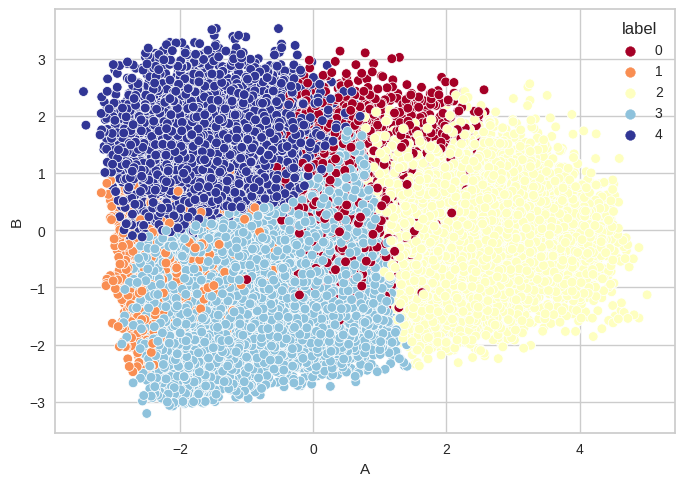

In [85]:
sns.scatterplot(data=dfc, x='A', y='B', hue='label', palette='RdYlBu')
plt.show()

In [86]:
print(abs(pca.components_))

[[0.20897545 0.48012056 0.60670504 0.58987697 0.09883144]
 [0.44609922 0.19404501 0.03142975 0.1128357  0.86580731]]


In [87]:
dfx_std.columns

Index(['LOYALTY_MONTH', 'LAST_TO_END', 'FLIGHT_COUNT', 'SEG_KM_SUM',
       'avg_discount', 'label'],
      dtype='object')

Data di atas berurutan dari kiri ke kanan sebagai berikut:
'LOYALTY_MONTH', 'LAST_TO_END', 'FLIGHT_COUNT', 'SEG_KM_SUM', 'avg_discount'

Sehingga dapat disimpulkan bahwa..

**PC-A Top Feature:**
1. FLIGHT_COUNT
2. SEG_KM_SUM
3. LAST_TO_END
4. LOYALTY_MONTH
5. avg_discount

Sementara itu..

**PC-B Top Feature:**
1. avg_discount
2. LOYALTY_MONTH
3. LAST_TO_END
4. SEG_KM_SUM
5. FLIGHT_COUNT

### **STATISTICAL SUMMARY**

In [88]:
# Revert back tranformed and data into original

list_log = ['LOYALTY_MONTH', 'LAST_TO_END', 'FLIGHT_COUNT', 'SEG_KM_SUM']

for i in list_log:
    dfx_ftr[i] = np.exp(dfx_ftr[i])
    dfx_ftr[i] = dfx_ftr[i]

In [89]:
# Change columns into LRFMC
dfx_ftr.columns =['L', 'R', 'F', 'M', 'C']
dfx_ftr

,L,R,F,M,C
41,39.0,4.0,36.0,201142.0,0.998555
62,47.0,7.0,85.0,186822.0,0.938031
63,36.0,15.0,97.0,204613.0,0.848240
66,78.0,89.0,33.0,182564.0,0.944650
70,20.0,63.0,19.0,209912.0,0.811871
...,...,...,...,...,...
62951,14.0,10.0,3.0,1001.0,0.307120
62952,18.0,499.0,3.0,761.0,0.400000
62959,14.0,132.0,3.0,959.0,0.290000
62973,13.0,358.0,3.0,761.0,0.350000


In [90]:
# Stats

dfx_ftr['label'] = kmeans.labels_
dfx_ftr.groupby('label').agg(['mean', 'median', 'std'])

L                             R                             F  \
            mean median        std        mean median         std       mean   
label                                                                          
0      25.531330   24.0   8.606504   81.705259   49.0   89.304120  13.731418   
1      24.040927   23.0   7.624563  333.598413  315.0  188.138543   4.580028   
2      68.231043   69.0  24.693785   34.666340   18.0   44.546939  30.854575   
3      71.132992   71.0  19.921326  207.227349  155.0  173.251234   7.408167   
4      37.398912   32.0  21.534673  265.830354  222.0  190.496402   4.724437   

                                    M                                C  \
      median        std          mean   median           std      mean   
label                                                                    
0       12.0   6.722871  18957.590278  16164.0  11954.941380  0.708278   
1        4.0   1.733519   4972.646392   4201.0   3274.951332  0.787934   
2       26.0  17.107910  41627.870061  34696.0  25253.620470  0.723297   
3        7.0   3.888757   9260.671822   7880.5   6495.998850  0.738578   
4        4.0   1.920703   5857.833352   5014.0   3702.255220  0.496922   

                           
         median       std  
label                      
0      0.705525  0.112184  
1      0.775000  0.101522  
2      0.723124  0.104320  
3      0.733325  0.118794  
4      0.506401  0.088628

In [91]:
# Check the ratio of each cluster in percentage

cluster_count = dfx_ftr['label'].value_counts().reset_index()
cluster_count.columns = ['label', 'count']
cluster_count['percentage (%)'] = round((cluster_count['count']/len(dfx_std))*100,2)
cluster_count = cluster_count.sort_values(by=['label']).reset_index(drop=True)
cluster_count

,label,count,percentage (%)
0,0,11315,20.59
1,1,7941,14.45
2,2,11236,20.45
3,3,15452,28.12
4,4,9007,16.39


Text(0, 0.5, 'Value')

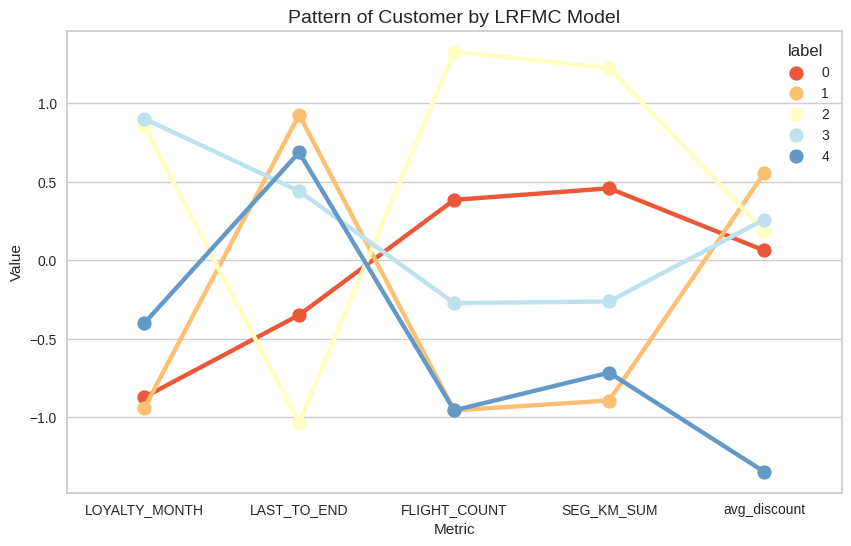

In [92]:
# Check each cluster's pattern based on LRFMC

cluster_med=dfx_std.groupby('label').median().reset_index()

df_melt = pd.melt(cluster_med.reset_index(), id_vars='label', value_vars=lrfmc, var_name='Metric', value_name='Value')
plt.figure(figsize=(10,6))
sns.pointplot(data=df_melt, x='Metric', y='Value', hue='label', palette='RdYlBu')
plt.title('Pattern of Customer by LRFMC Model', fontsize=14)
plt.xlabel('Metric')
plt.ylabel('Value')

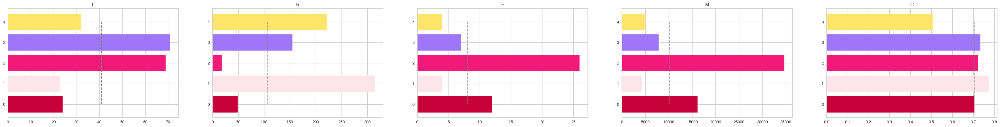

In [93]:
c = ["#C70039","#FDE5EC","#F11A7B","#A076F9","#FFE569"]

LRFMC= ['L','R','F','M','C']
def dist_list(lst):
    plt.figure(figsize=[len(lst)*9,5])
    i = 1
    for col in lst:
        ax = plt.subplot(1,len(lst),i)
        ax.vlines(dfx_ftr[col].median(), ymin=0, ymax=4, color='grey', linestyle='--')
        g = dfx_ftr.groupby('label')
        x = g[col].median().index
        y = g[col].median().values
        ax.barh(x,y, color=c)
        plt.title(col)
        i = i+1

dist_list(LRFMC)

L: low: 0, 1, average: 4, high: 2, 3
R: low: 0, 2, average: 3, high: 1, 4
F: low: 1, 4, average: 3, high: 0, 2
M: low: 1, 4, average: 3, high: 0, 2
C: low: 0, 4, average: 2, high: 1, 3


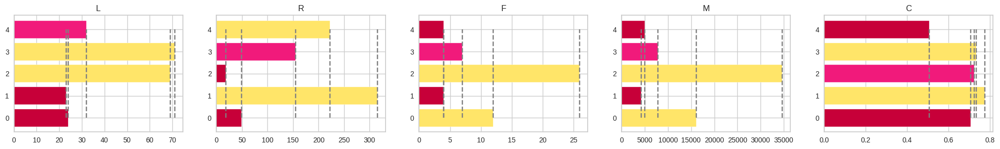

In [94]:
from tabulate import tabulate

c = ["#C70039", "#FDE5EC", "#F11A7B", "#A076F9", "#FFE569"]

LRFMC = ['L', 'R', 'F', 'M', 'C']

def categorize_median(value, low_threshold, high_threshold):
    if value < low_threshold:
        return 'low'
    elif value >= high_threshold:
        return 'high'
    else:
        return 'average'

def dist_list(lst):
    output = []
    plt.figure(figsize=[len(lst) * 5, 3])
    i = 1
    for col in lst:
        ax = plt.subplot(1, len(lst), i)
        median_col = dfx_ftr.groupby('label')[col].median()
        low_threshold = median_col.quantile(1/3)
        high_threshold = median_col.quantile(2/3)

        ax.vlines(median_col, ymin=0, ymax=4, color='grey', linestyle='--')

        g = dfx_ftr.groupby('label')
        x = g[col].median().index
        y = g[col].median().values

        categorized_y = [categorize_median(value, low_threshold, high_threshold) for value in y]
        colors = [c[0] if cat == 'low' else c[2] if cat == 'average' else c[4] for cat in categorized_y]

        ax.barh(x, y, color=colors)
        plt.title(col)

        # Print categorized features
        low_features = [f'{feat}' for feat, cat in zip(x, categorized_y) if cat == 'low']
        average_features = [f'{feat}' for feat, cat in zip(x, categorized_y) if cat == 'average']
        high_features = [f'{feat}' for feat, cat in zip(x, categorized_y) if cat == 'high']

        print(f"{col}: low: {', '.join(low_features)}, average: {', '.join(average_features)}, high: {', '.join(high_features)}")

        i = i + 1

dist_list(LRFMC)

**Analisis Komponen Cluster:**

1. Cluster 0:
 - Cluster member baru
 - Penerbangan terakhir tidak jauh dari waktu pengamatan
 - Frekuensi penerbangan average
 - Akumulasi mileage average
 - Penggunaan diskon rendah
**Conclusion: Customer baru potensial**

2. Cluster 1:
 - Cluster passenger yang tergolong member baru
 - History penerbangan terakhir yang jauh dengan waktu pengamatan
 - Frekuensi penerbangan rendah
 - Jarak tempuh penerbangan yang diakumulasikan rendah
 - Penggunaan diskonnya juga rendah.
**Conclusion: Customer baru**

3. Cluster 2:
 - Cluster passenger yang tergolong member lama
 - History penerbangan terakhir dekat dengan waktu pengamatan
 - Rentang frekuensi penerbangan tinggi
 - Telah mengakumulasikan jarak penerbangan yang tinggi
 - Aktif menggunakan diskon.
**Conclusion: Customer loyal**

4. Cluster 3:
 - Cluster member lama
 - History penerbangan terakhir yang tidak jauh tapi juga tidak dekat dengan waktu pengamatan
 - Frekuensi penerbangan tinggi
 - Akumulasi mileage tinggi
 - Penggunaan diskon yang average.
**Conclusion: Customer lama potential**

5. Cluster 4:
 - Cluster passenger yang tidak tergolong member lama maupun member baru
 - History penerbangan terakhir yang sudah jauh dari waktu pengamatan
 - Frekuensi penerbangan yang rendah
 - Akumulasi jarak penerbangan rendah
 - Namun, penggunaan diskon tinggi.
**Conclusion: Customer budget**

## **REKOMENDASI BISNIS**

Berdasarkan hasil analisis komponen cluster, maka rekomendasi bisnis yang dapat kami berikan kepada perusahaan adalah sebagai berikut:

**Rekomendasi umum:**
 - Evaluasi benefit membership lebih disesuaikan dengan tier dan cluster member. Sistemnya semakin tinggi frekuensi penerbangan, maka akan semakin tinggi pula tier membershipnya. Hal ini dimaksudkan untuk memaksimalkan profit perusahaan dengan meningkatkan jumlah member loyal, mempertahankannya dan menambah jumlah customer potensial dari cluster customer baru dan customer budget.
 - Melakukan campaign referral / mengajak orang lain join membership dan melakukan penerbangan dengan maskapai ini untuk mendapatkan rewards berupa poin/voucher diskon limited/tiket gratis dnegan SnK tertentu.
 - Memaksimalkan sistem poin yang sudah ada. Memberikan benefit berdasarkan total poin yang dikumpulkan dan dapat menggunakan poin dalam jumlah minimal tertentu untuk potongan harga pada transaksi pembelian yang dilakukan.


**Rekomendasi per cluster:**
1. Cluster 2: Customer Loyal
  - Memberikan prioritas dan benefit khusus untuk member loyal agar merasa dihargai dan tetap menggunakan maskapai penerbangan ini

2. Cluster 4: Customer Budget
  - Memberikan lebih banyak voucher diskon dengan SnK tertentu (minimum spending dan maximum potongan harga)

3. Cluster 1: Customer Baru
  - Membuat program 'New Membership' dengan periode tertentu. Program terdiri dari misi tarnsaksi baik berupa pembelian tiket atau pembelian adds-on. Selain itu, dapat berupa memberikan voucher diskon khusus member baru dengan benefit tertentu.
  - Memberikan newsletter tentang sistem membership dan sistem poin agar lebih aware terhadap program-rogram perusahaan.

4. Cluster 0: Customer Baru Potensial
  - Membuat program 'New Membership' dengan periode tertentu. Program terdiri dari misi tarnsaksi baik berupa pembelian tiket atau pembelian adds-on. Selain itu, dapat berupa memberikan voucher diskon khusus member baru dengan benefit tertentu.
  - Lebih sering memberikan newsletter info penerbangan (sale/holiday season dll)
  - Memberikan offering tour package khusus member baru

5. Cluster 3: Customer Lama Potensial
  - Lebih sering memberikan newsletter info penerbangan (sale/holiday season dll)
  - Memberikan offering tour package khusus member lama
